In [1]:
%matplotlib inline

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
df = pd.read_excel(r"D:\Data\esc\eurovision_song_contest_1975_2016.xlsx")
df.head()

,Year,(semi-) final,Edition,Jury or Televoting,From country,To country,Points
0,1975,f,1975f,J,Belgium,Belgium,0
1,1975,f,1975f,J,Belgium,Finland,0
2,1975,f,1975f,J,Belgium,France,2
3,1975,f,1975f,J,Belgium,Germany,0
4,1975,f,1975f,J,Belgium,Ireland,12


In [3]:
# coco = pd.read_csv(r"D:\Data\esc\NFA 2016 country code correspondence table .csv", usecols=['Country Name', 'ISO Alpha-3 Code'])
# coco.columns = ['Country', 'Country code']

# coco.head()

,Country,Country code
0,Armenia,ARM
1,Afghanistan,AFG
2,Albania,ALB
3,Algeria,DZA
4,American Samoa,ASM


In [199]:
dff = df[df['(semi-) final'] == 'f']

# dff = pd.merge(dff, coco, left_on='From country', right_on='Country')
# dff = pd.merge(dff, coco, left_on='To country', right_on='Country', suffixes=['_from', '_to'])

dff.head()

,Year,(semi-) final,Edition,Jury or Televoting,From country,To country,Points
0,1975,f,1975f,J,Belgium,Belgium,0
1,1975,f,1975f,J,Belgium,Finland,0
2,1975,f,1975f,J,Belgium,France,2
3,1975,f,1975f,J,Belgium,Germany,0
4,1975,f,1975f,J,Belgium,Ireland,12


In [200]:
dffp = pd.pivot_table(dff, index=['Year', 'To country'], columns=['From country'], values='Points').fillna(0)
dffp['tot_points'] = dffp.sum(1)
dffp.head()

From country     Albania  Andorra  Armenia  Australia  Austria  Azerbaijan  \
Year To country                                                              
1975 Belgium           0        0        0          0        0           0   
     Finland           0        0        0          0        0           0   
     France            0        0        0          0        0           0   
     Germany           0        0        0          0        0           0   
     Ireland           0        0        0          0        0           0   

From country     Belarus  Belgium  Bosnia  Bosnia & Herzegovina     ...      \
Year To country                                                     ...       
1975 Belgium           0        0       0                     0     ...       
     Finland           0        0       0                     0     ...       
     France            0        2       0                     0     ...       
     Germany           0        0       0                     0     ...       
     Ireland           0       12       0                     0     ...       

From country     Slovenia  Spain  Sweden  Switzerland  The Netherlands  \
Year To country                                                          
1975 Belgium            0      0       2            0                5   
     Finland            0      1       3           12                0   
     France             0      8       8            3                8   
     Germany            0      4       0            0                0   
     Ireland            0      3      10            7                6   

From country     Turkey  Ukraine  United Kingdom  Yugoslavia  tot_points  
Year To country                                                           
1975 Belgium          0        0               0           3          17  
     Finland          0        0               4           5          74  
     France           1        0               8           0          91  
     Germany          0        0               0           0          15  
     Ireland          0        0               6           1          68  

[5 rows x 54 columns]

### network

In [201]:
import networkx as nx

nx.__version__

'1.11'

#### 2011 - 2016

In [202]:
dffp10 = dffp.loc[(2011,), :]\
    .append(dffp.loc[(2012,), :])\
    .append(dffp.loc[(2013,), :])\
    .append(dffp.loc[(2014,), :])\
    .append(dffp.loc[(2015,), :])\
    .append(dffp.loc[(2016,), :]).drop('tot_points', 1)
print dffp10.shape
dffp10.head()

(156, 53)


From country,Albania,Andorra,Armenia,Australia,Austria,Azerbaijan,Belarus,Belgium,Bosnia,Bosnia & Herzegovina,...,Slovakia,Slovenia,Spain,Sweden,Switzerland,The Netherlands,Turkey,Ukraine,United Kingdom,Yugoslavia
To country,,,,,,,,,,,,,,,,,,,,,
Austria,0,0,3,0,0,0,0,0,0,7,...,3,5,0,4,7,1,1,0,2,0
Azerbaijan,8,0,0,0,8,0,6,3,0,8,...,7,0,0,3,1,6,12,10,0,0
Bosnia & Herzegovina,7,0,0,0,12,0,0,0,0,0,...,0,12,0,8,12,8,10,0,0,0
Denmark,0,0,0,0,0,0,1,0,0,0,...,6,8,0,10,0,12,0,0,5,0
Estonia,0,0,0,0,0,0,0,2,0,0,...,0,0,0,0,0,0,0,2,0,0


In [203]:
dffp10_m = dffp10.groupby(level=0).mean()
dff10_m = dffp10_m.unstack().reset_index(name='edge_value')

dff10_m.head()

,From country,To country,edge_value
0,Albania,Albania,0.000000
1,Albania,Armenia,0.250000
2,Albania,Australia,7.500000
3,Albania,Austria,1.250000
4,Albania,Azerbaijan,3.166667


In [204]:
G10 = nx.from_pandas_dataframe(dff10_m, source='From country', target='To country', edge_attr='edge_value')

In [205]:
def normalise(x):
    return (x - x.mean())/x.std()

def zero_one_ize(x):
    return (x - x.min()) / (x.max() - x.min())

(<matplotlib.figure.Figure at 0x21059c18>,
 <matplotlib.axes._subplots.AxesSubplot at 0x69e296a0>)

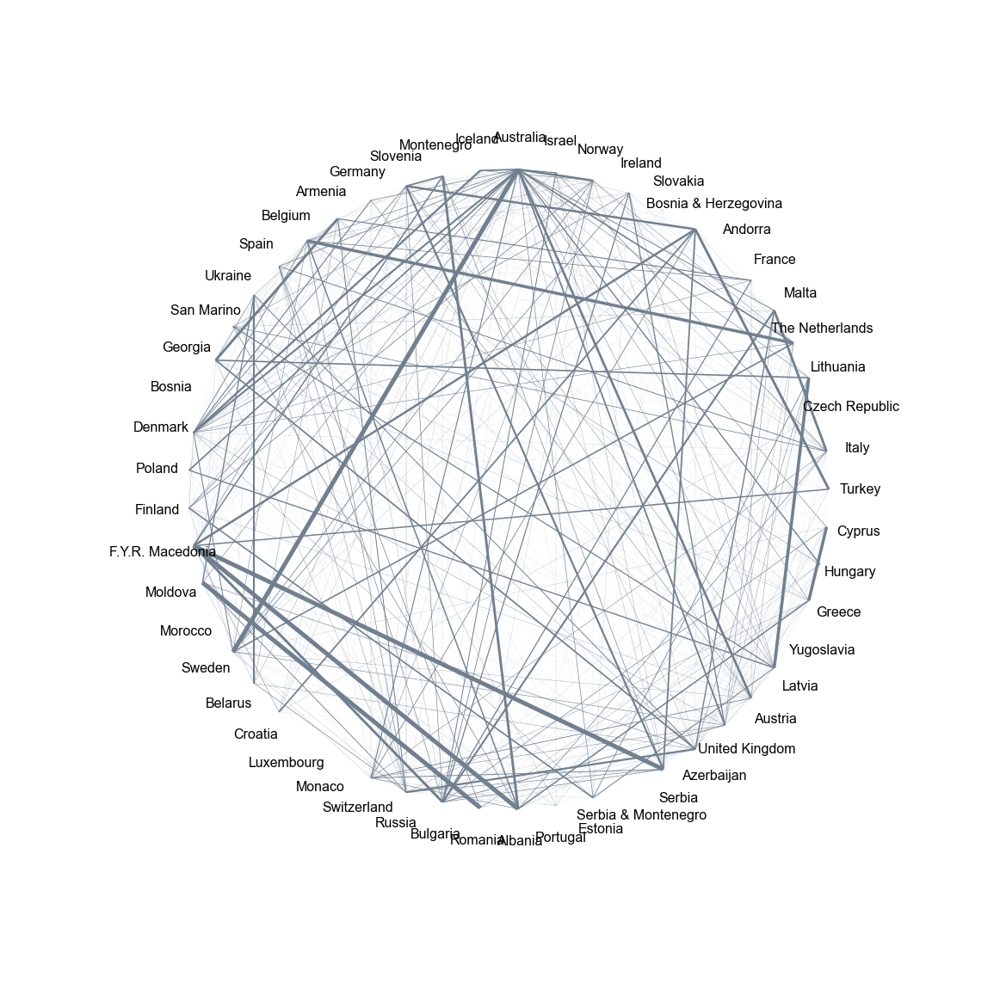

In [206]:
def update_graph_circle(fig, ax, graph, wa=5, wq=3, label_expl=1.1, node_color='steelblue', edge_color='steelblue'):
    pos = nx.circular_layout(graph)#, k=3.1/np.sqrt(G10.number_of_nodes()))
    pos_lab = {k:v*label_expl for k,v in pos.iteritems()}
    ww = np.array([graph[u][v]['edge_value'] for u,v in graph.edges()])
    ww = zero_one_ize(ww)
    
    graphd = nx.draw(graph, pos=pos, ax=ax, width=(wa*ww**wq), node_color=node_color, edge_color=edge_color, node_size=0)
    foo = nx.draw_networkx_labels(graph, pos=pos_lab, ax=ax, font_size=16)
    
    return fig, graphd

def draw_graph_circle(graph, wa=5, wq=3, label_expl=1.1, node_color='steelblue', edge_color='steelblue'):
    fig, ax = plt.subplots(1, 1, figsize=[20,20])
    fig, graphd = update_graph_circle(fig, ax, graph, wa, wq, label_expl, node_color=node_color, edge_color=edge_color)    
    return fig, ax

draw_graph_circle(G10, node_color='slategrey', edge_color='slategrey')

In [207]:
edgelist = dff[['From country', 'To country']].drop_duplicates().values
GAll = nx.from_edgelist(edgelist, create_using=nx.Graph())

def makeGraph(graph, from_year, to_year):
    dffm_ = dff[dff['Year'].isin(range(from_year, to_year+1))]\
        .groupby(['From country', 'To country'])['Points'].mean()
    for from_c, to_c in graph.edges():
        fromtoval = (dffm_.loc[(from_c, to_c)] if (from_c, to_c) in dffm_.index else 0)
        tofromval = (dffm_.loc[(to_c, from_c)] if (to_c, from_c) in dffm_.index else 0)
#         graph[from_c][to_c]['edge_value'] = fromtoval + tofromval
#         graph[from_c][to_c]['edge_value'] = min(fromtoval, tofromval)
#         graph[from_c][to_c]['edge_value'] = (fromtoval >= 6) * (tofromval >= 6) * (fromtoval + tofromval)
        graph[from_c][to_c]['edge_value'] = (fromtoval + tofromval) * min(fromtoval, tofromval)
    return graph

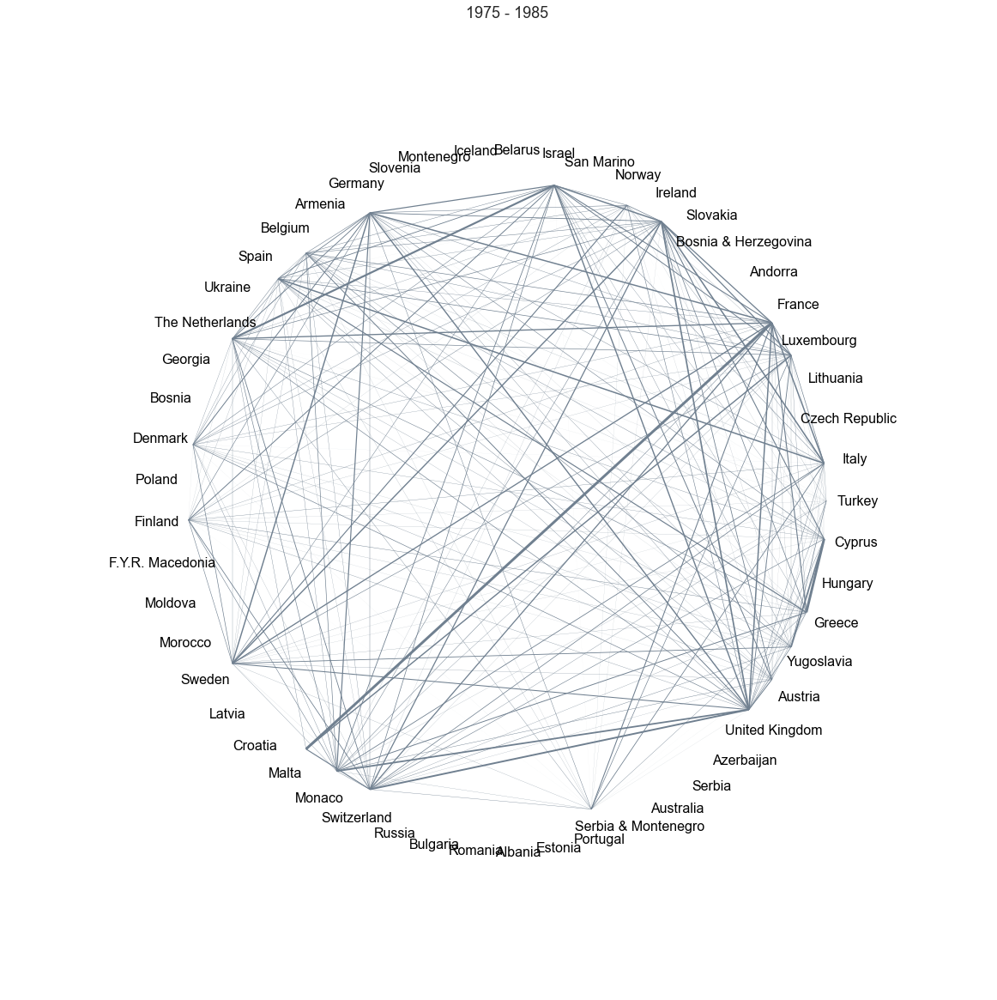

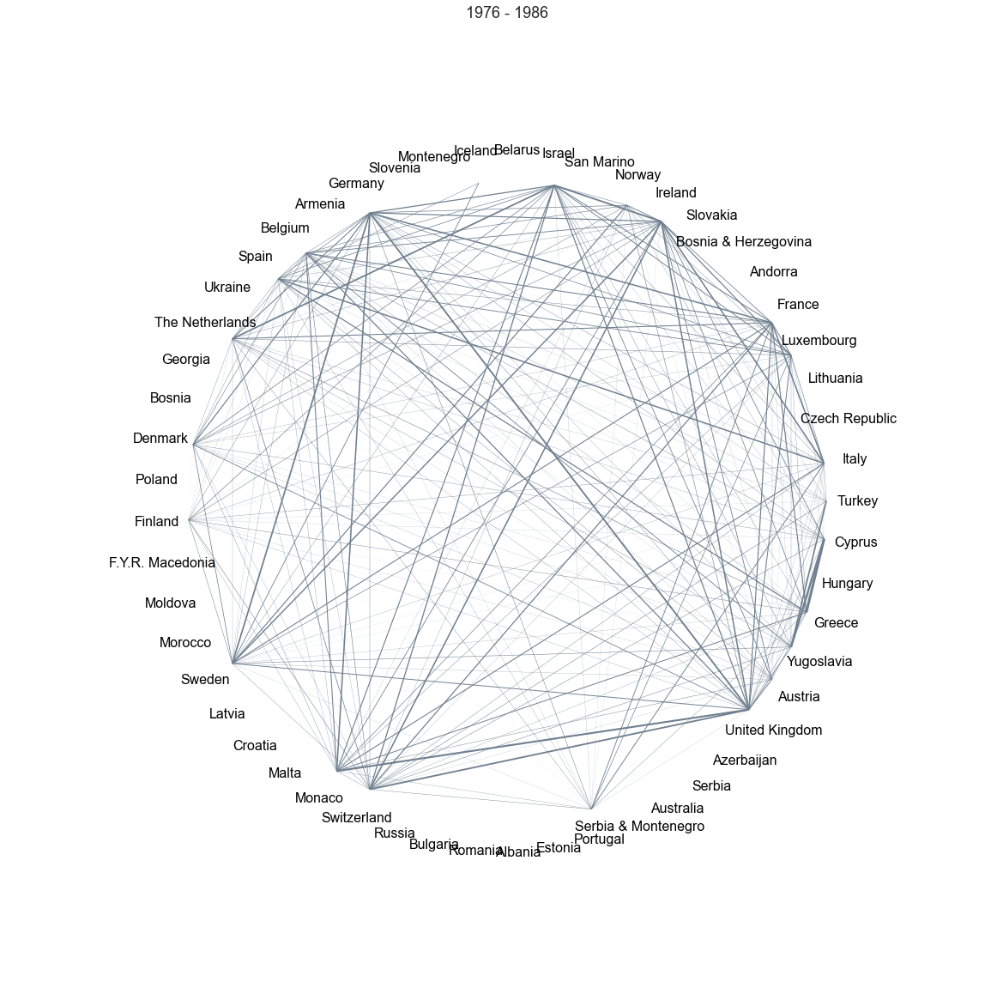

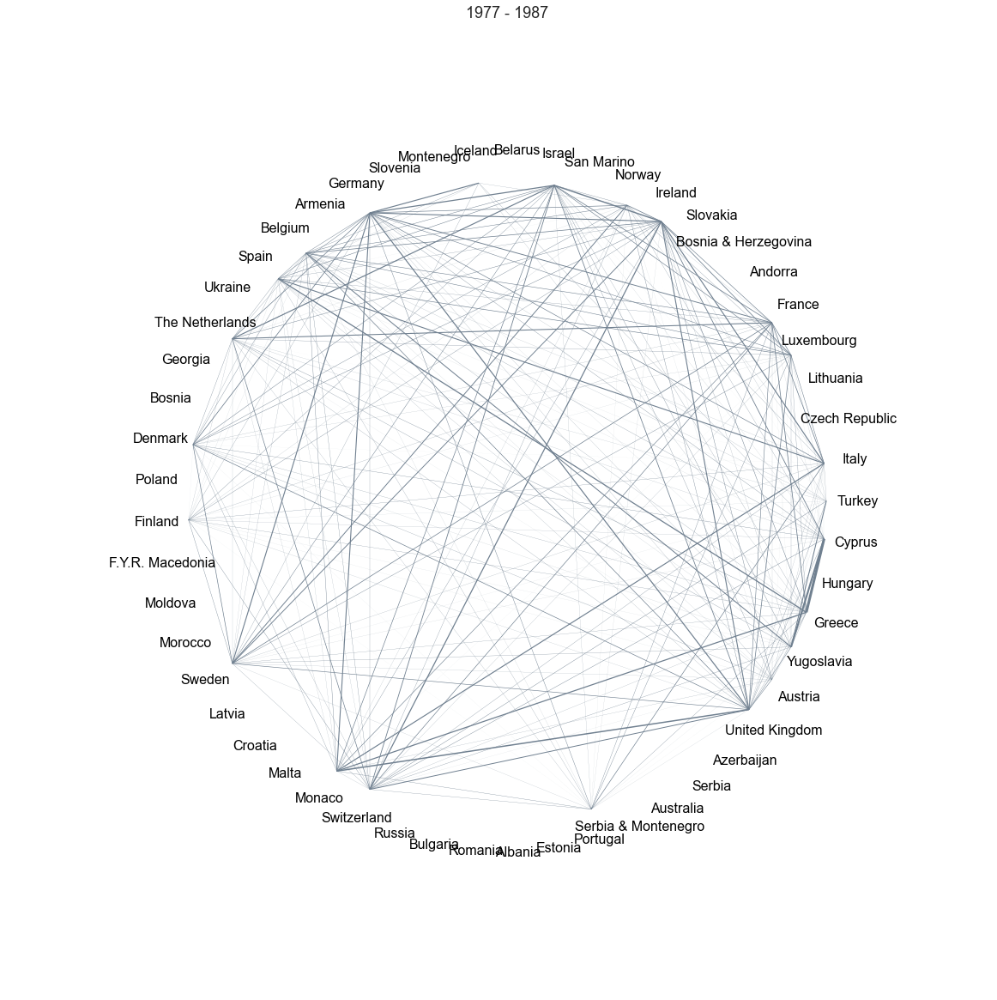

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


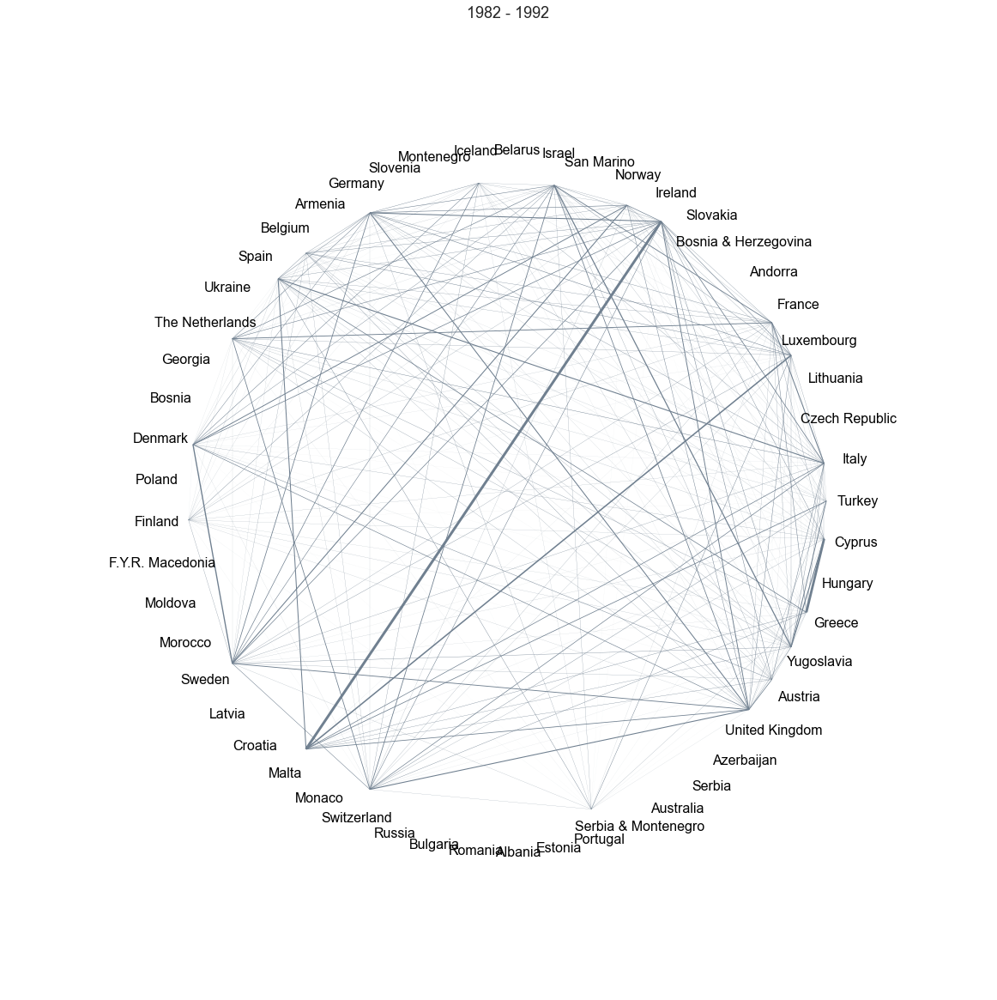

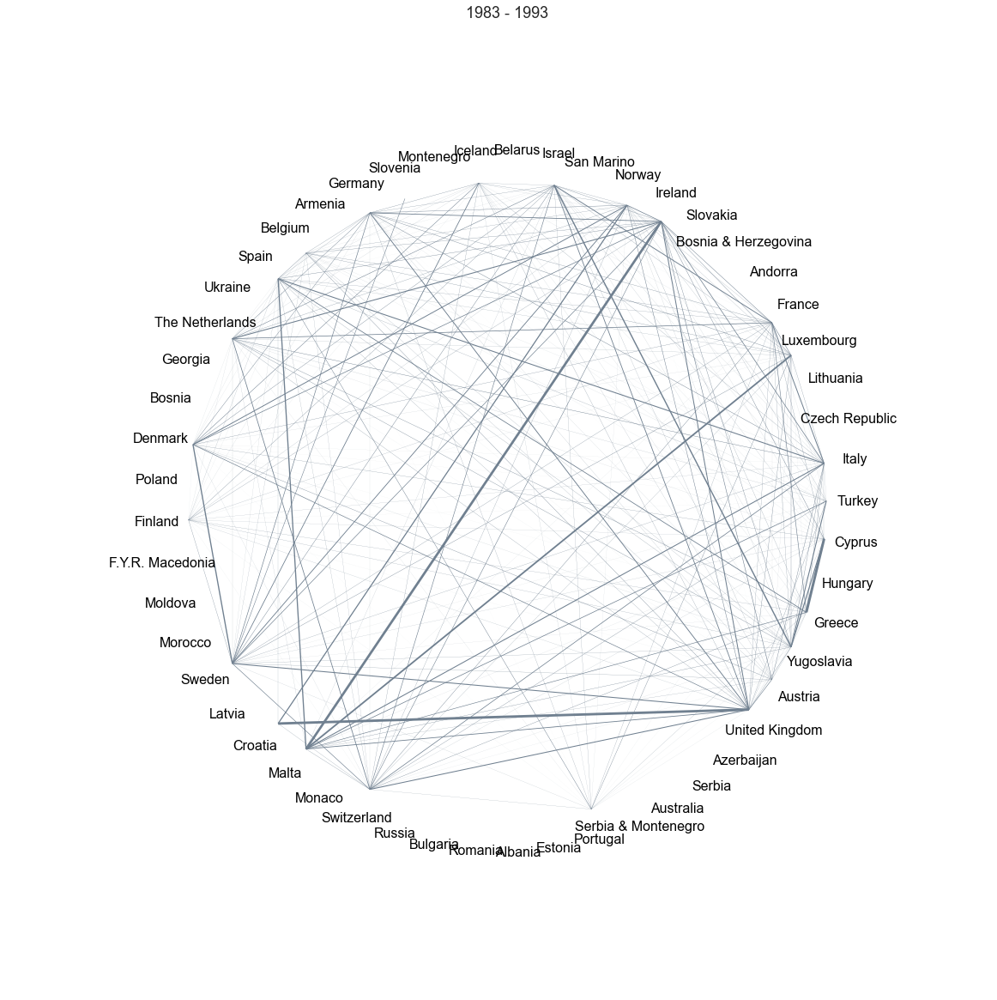

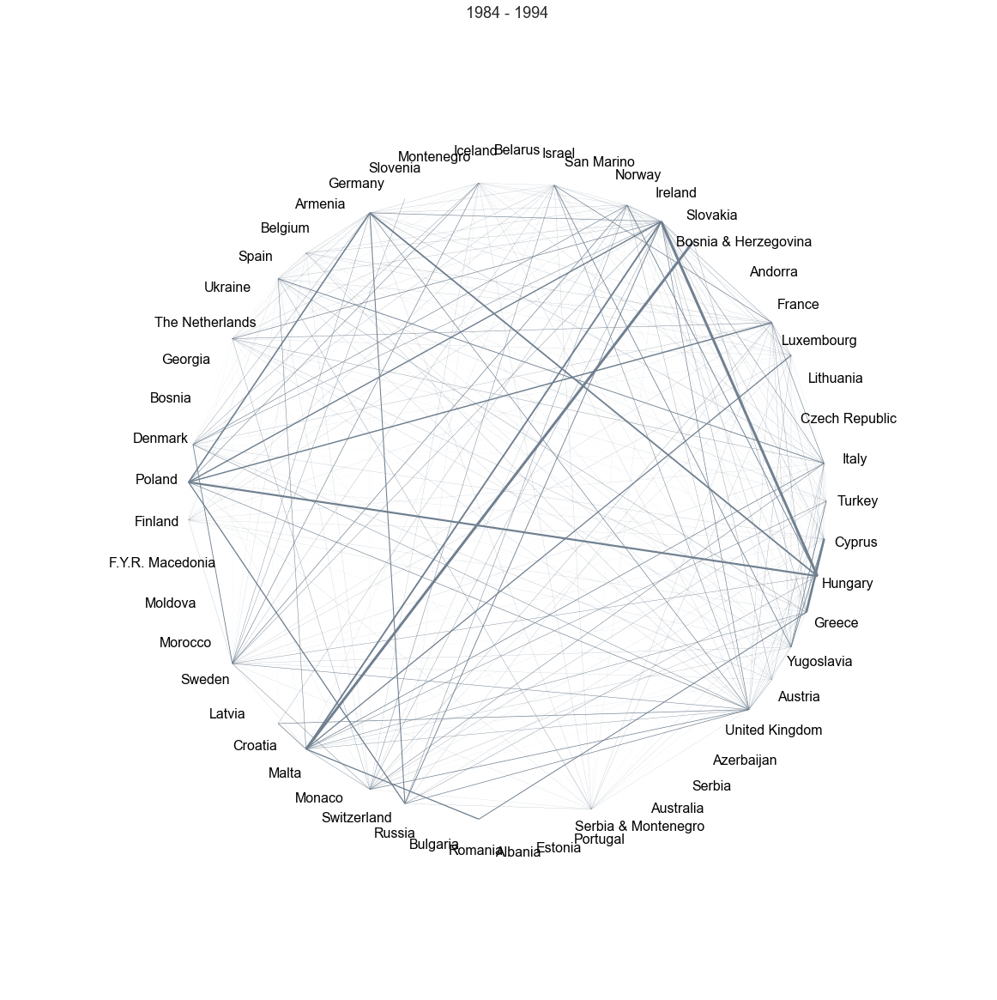

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


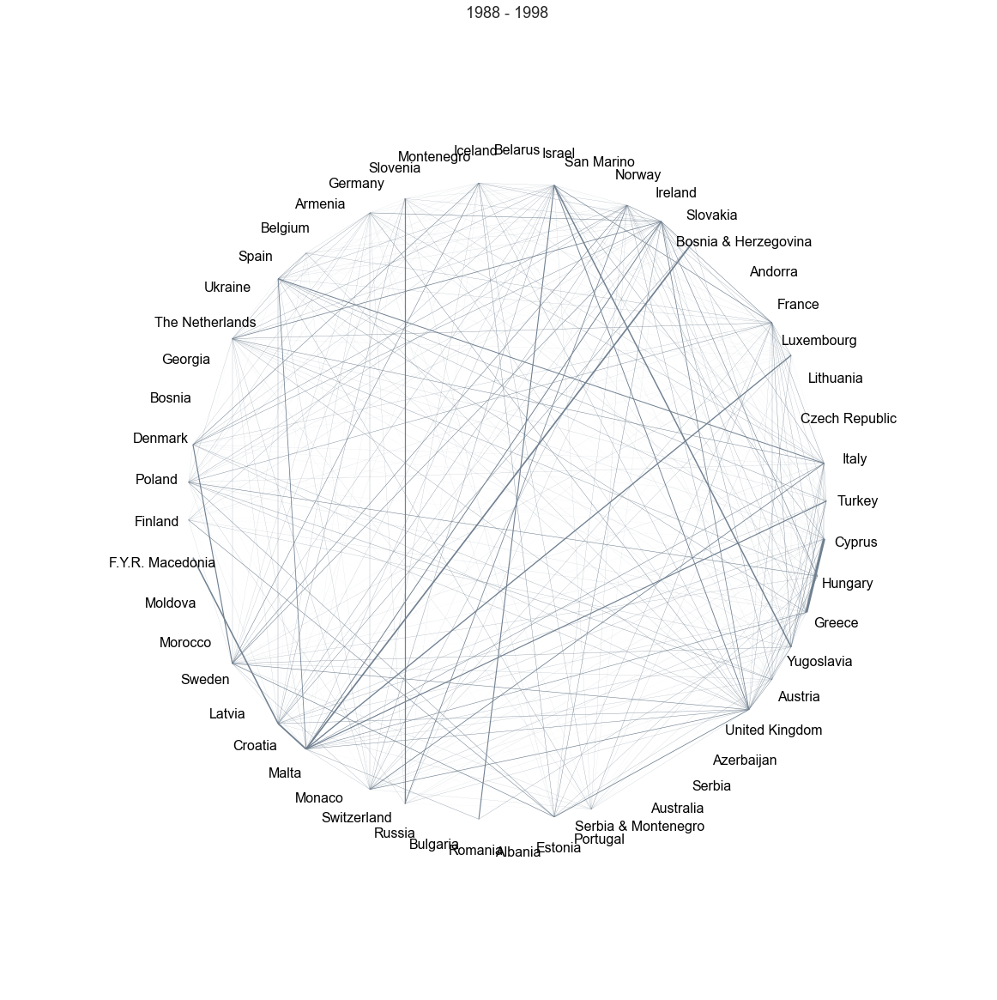

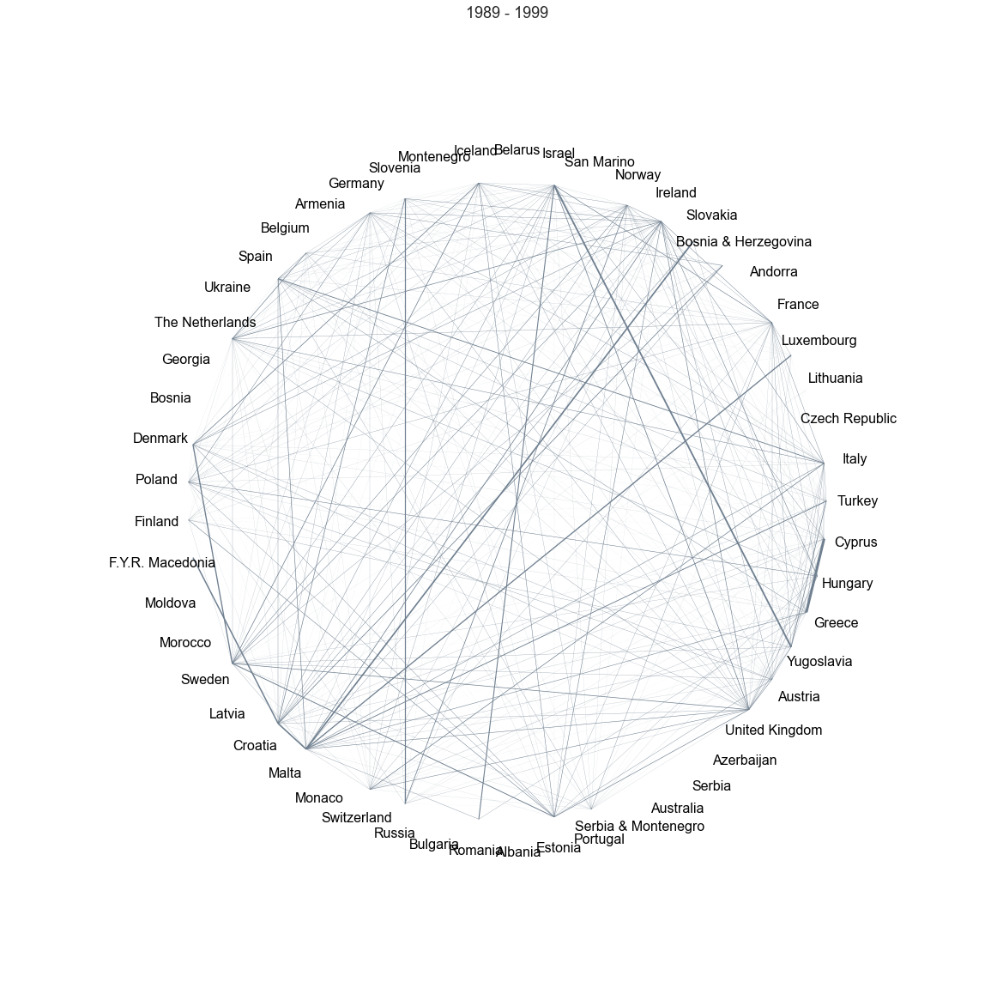

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


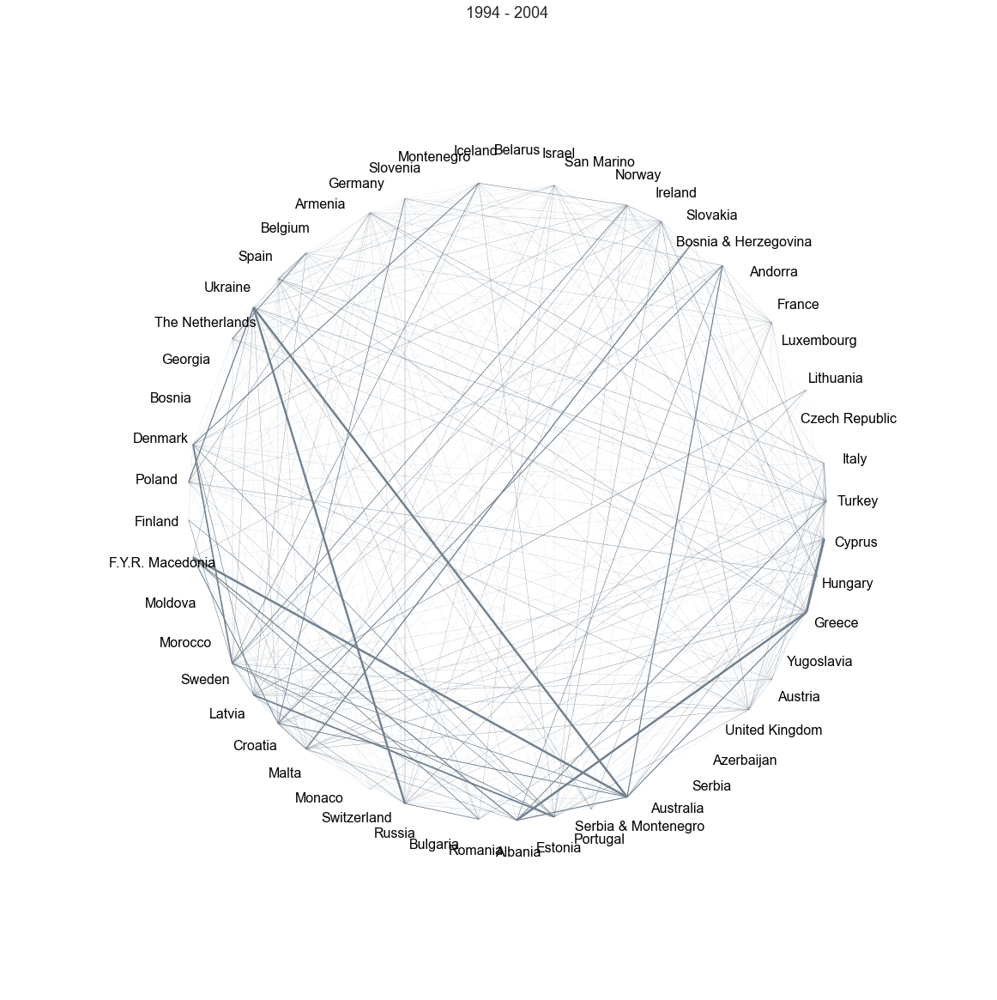

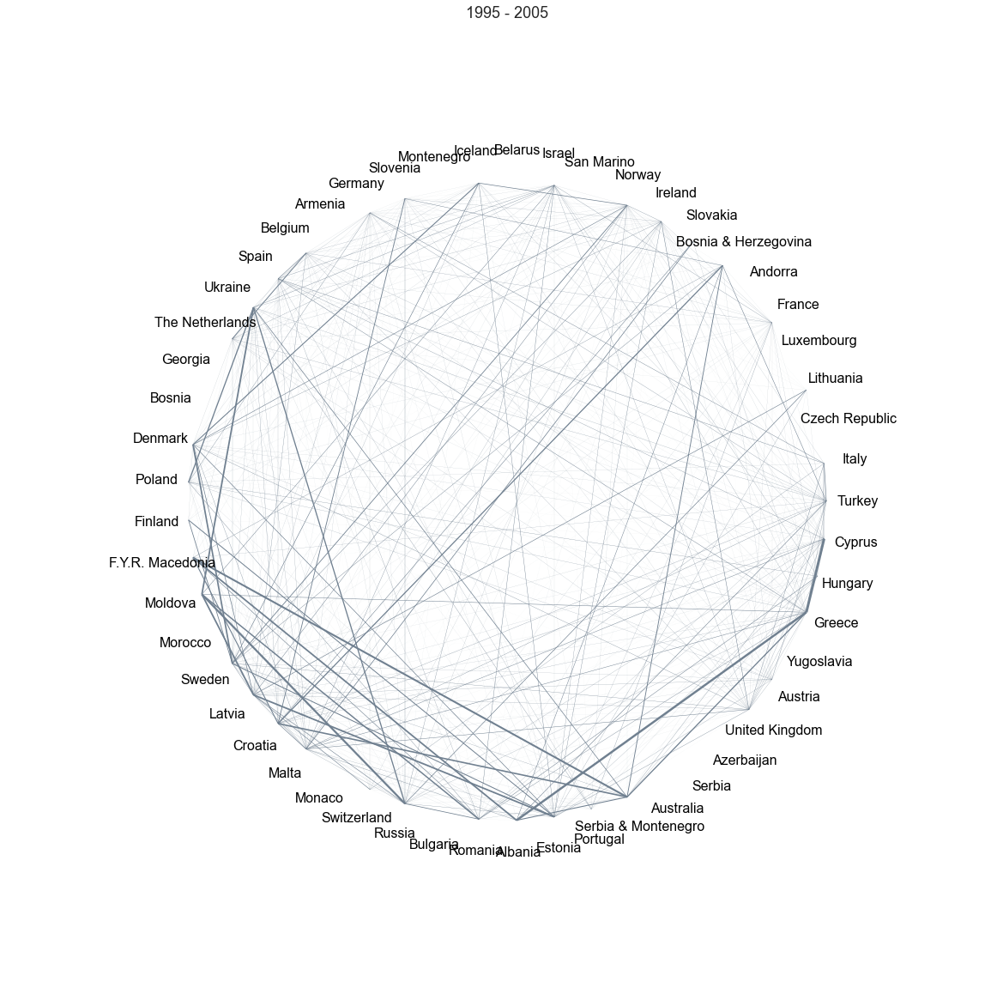

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


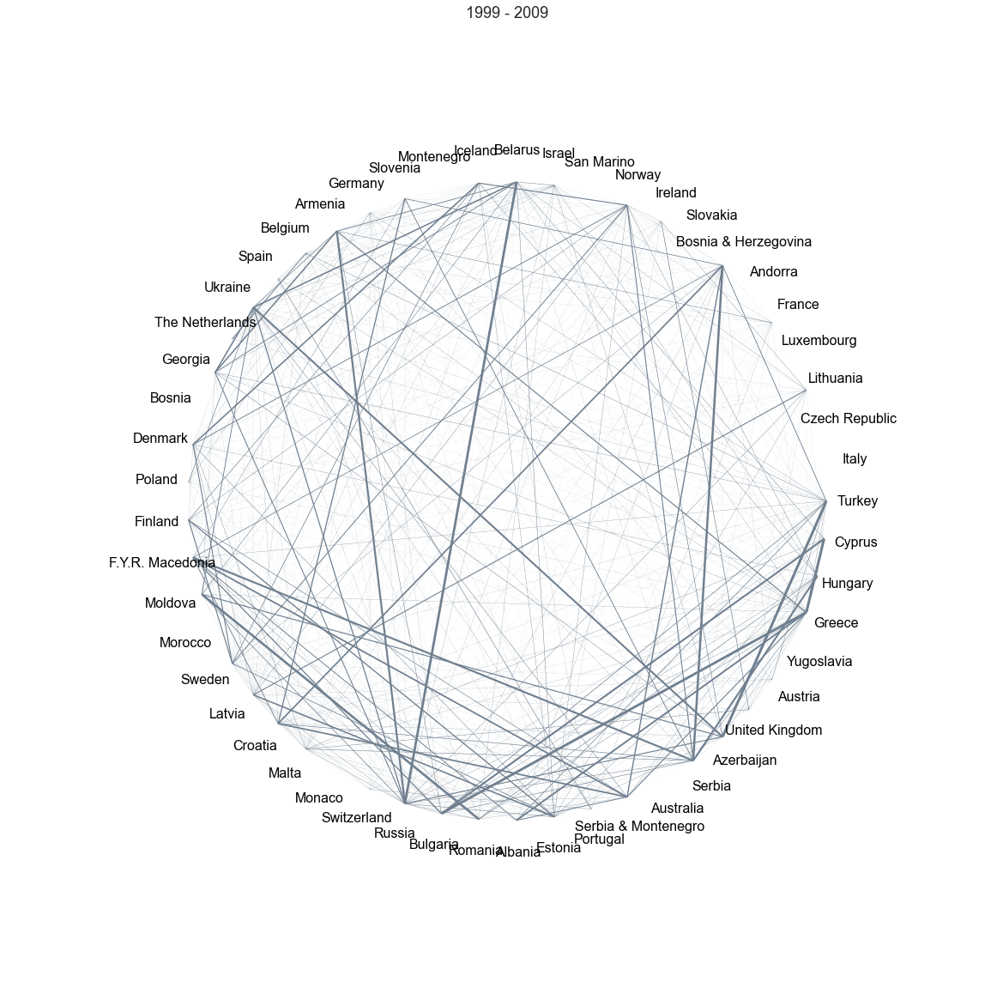

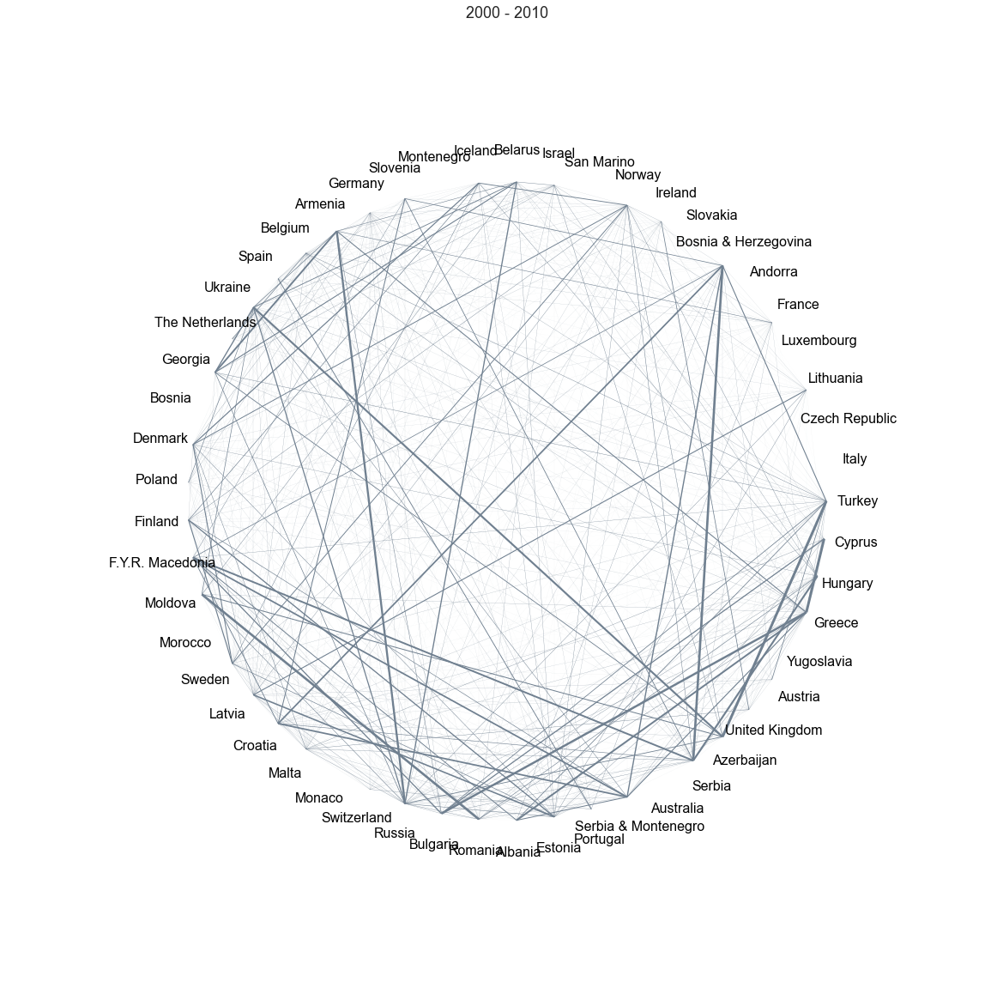

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


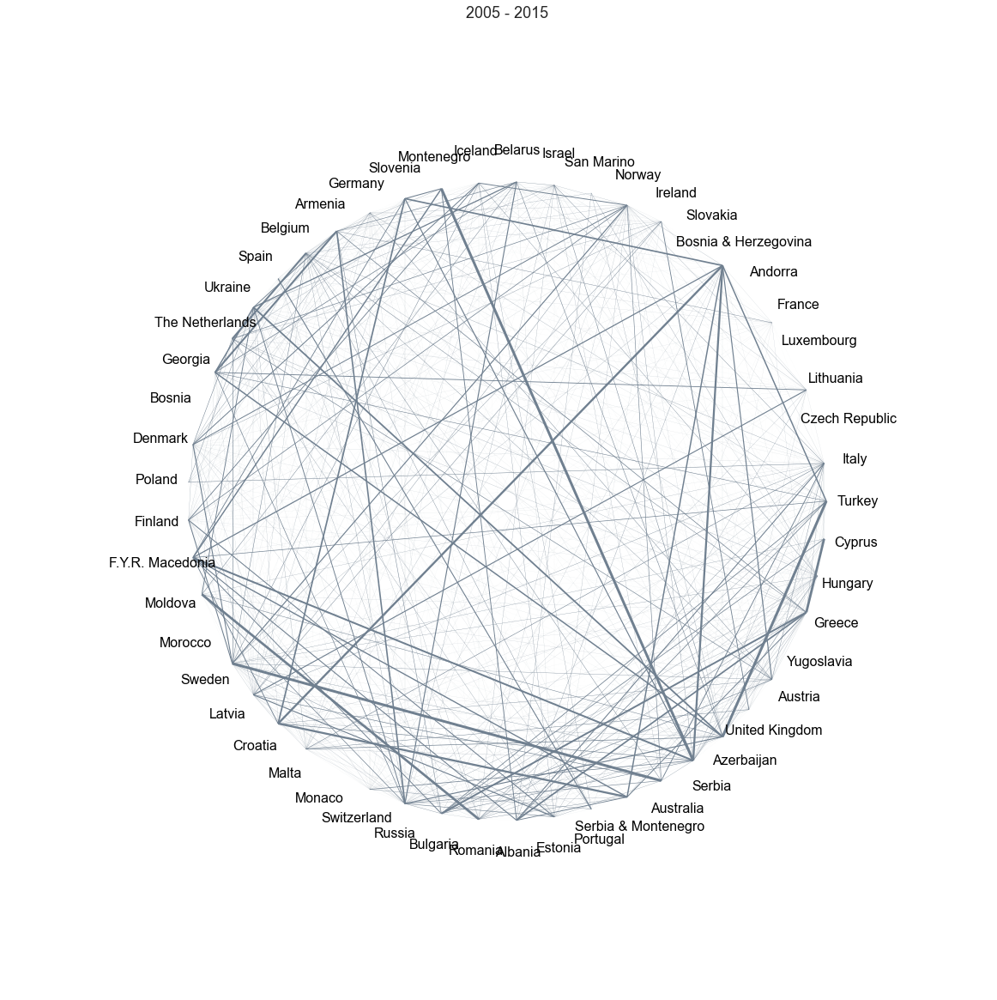

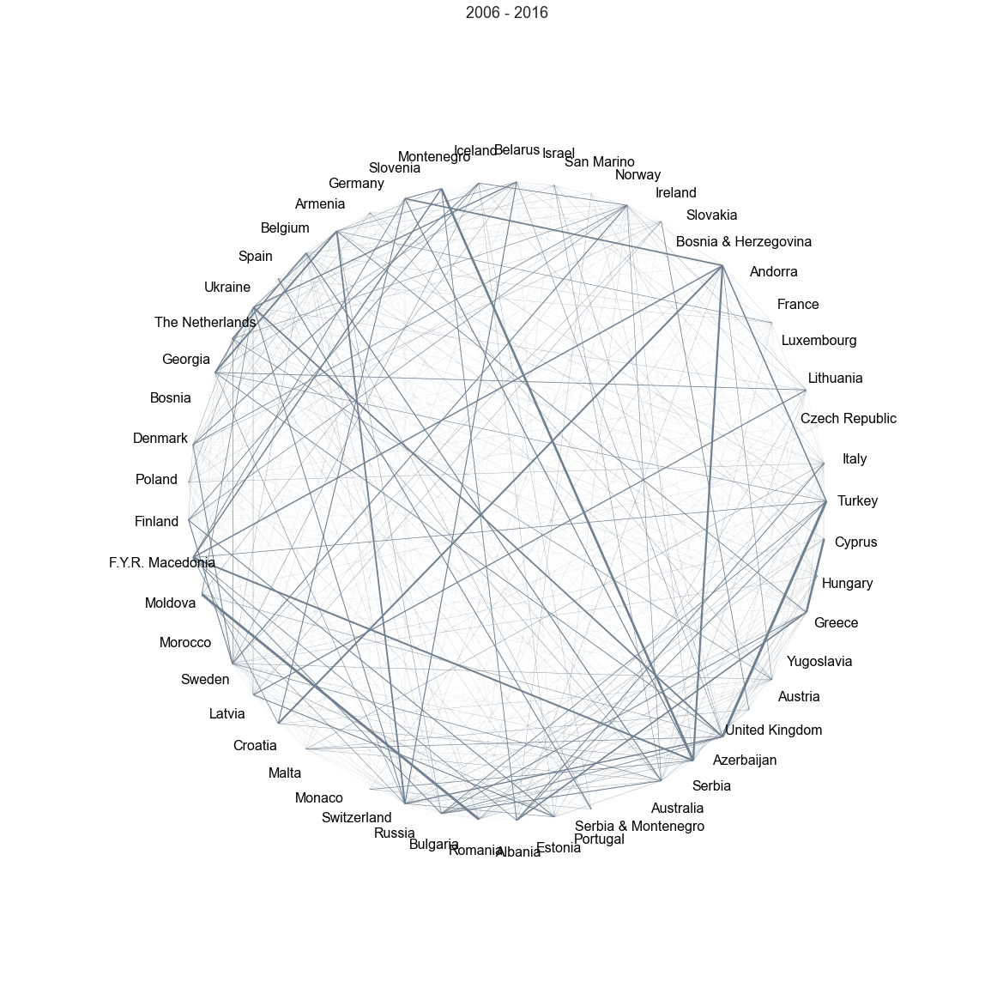

In [208]:
import os

savedir = './graphs/circle'

miny = 1975
maxy = 2017
span = 10

for i in range(maxy-miny-span):
    years_from = miny+i
    years_to = miny+span+i
    G_ = makeGraph(GAll, years_from, years_to)
    fig, ax = draw_graph_circle(G_, wa=3, wq=1, node_color='slategrey', edge_color='slategrey')
    
    ax.set_title('%d - %d' %(years_from, years_to), fontsize=18)
    
    fig.savefig(os.path.join(savedir, '%d_%d.png' %(years_from, years_to)))
    


#### plot on a map

In [209]:
from mpl_toolkits.basemap import Basemap

In [285]:
coce = pd.read_csv('d:/data/esc/country-capitals.csv', sep=',')
coce.head()

,CountryName,CapitalName,CapitalLatitude,CapitalLongitude,CountryCode,ContinentName
0,Somaliland,Hargeisa,9.550000,44.050000,NaN,Africa
1,South Georgia and South Sandwich Islands,King Edward Point,-54.283333,-36.500000,GS,Antarctica
2,French Southern and Antarctic Lands,Port-aux-Français,-49.350000,70.216667,TF,Antarctica
3,Palestine,Jerusalem,31.766667,35.233333,PS,Asia
4,Aland Islands,Mariehamn,60.116667,19.900000,AX,Europe


In [286]:
coce = coce.append(coce[coce['CountryName'] == 'Serbia'])
coce.loc[coce['CountryName'] == 'Serbia', 'CountryName'] = ['Serbia', 'Serbia & Montenegro']
coce[coce['CountryName'].str.contains('Serbia')]

,CountryName,CapitalName,CapitalLatitude,CapitalLongitude,CountryCode,ContinentName
190,Serbia,Belgrade,44.833333,20.5,RS,Europe
190,Serbia & Montenegro,Belgrade,44.833333,20.5,RS,Europe


In [287]:
coce = coce.append(coce[coce['CountryName'] == 'Serbia'])
coce.loc[coce['CountryName'] == 'Serbia', 'CountryName'] = ['Serbia', 'Yugoslavia']
coce[coce['CountryName'].str.contains('Serbia') | coce['CountryName'].str.contains('Yugoslavia')]

,CountryName,CapitalName,CapitalLatitude,CapitalLongitude,CountryCode,ContinentName
190,Serbia,Belgrade,44.833333,20.5,RS,Europe
190,Serbia & Montenegro,Belgrade,44.833333,20.5,RS,Europe
190,Yugoslavia,Belgrade,44.833333,20.5,RS,Europe


In [288]:
coce = coce.append(coce[coce['CountryName'] == 'Bosnia and Herzegovina'])\
    .append(coce[coce['CountryName'] == 'Bosnia and Herzegovina'])
coce.loc[coce['CountryName'] == 'Bosnia and Herzegovina', 'CountryName'] = ['Bosnia', 'Bosnia and Herzegovina', 'Bosnia & Herzegovina']
coce[coce['CountryName'].str.contains('Bosnia')]

,CountryName,CapitalName,CapitalLatitude,CapitalLongitude,CountryCode,ContinentName
34,Bosnia,Sarajevo,43.866667,18.416667,BA,Europe
34,Bosnia and Herzegovina,Sarajevo,43.866667,18.416667,BA,Europe
34,Bosnia & Herzegovina,Sarajevo,43.866667,18.416667,BA,Europe


In [289]:
coce.loc[coce['CountryName'].str.contains('Macedonia'), 'CountryName'] = 'F.Y.R. Macedonia'
coce.loc[coce['CountryName'].str.contains('Netherlands'), 'CountryName'] = 'The Netherlands'

In [290]:
coce.loc[coce['CountryName'].str.contains('Bosnia'), 'CountryName']

34                    Bosnia
34    Bosnia and Herzegovina
34      Bosnia & Herzegovina
Name: CountryName, dtype: object

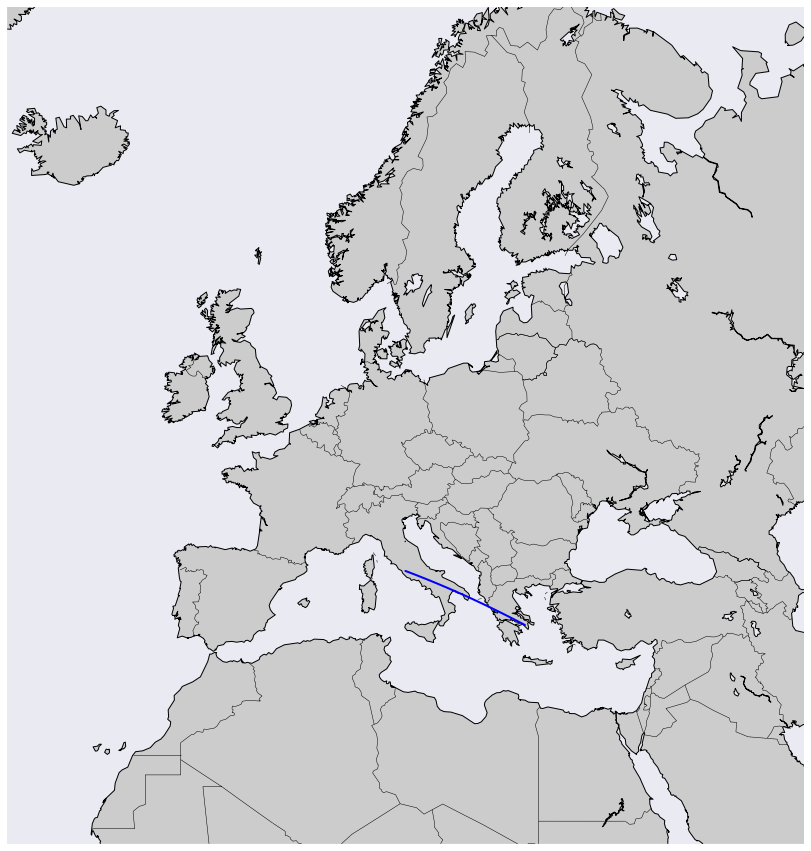

In [178]:
# create new figure, axes instances.
fig, ax = plt.subplots(figsize=[15,15])
# setup mercator map projection.
m = Basemap(llcrnrlon=-25.,llcrnrlat=20.,urcrnrlon=50.,urcrnrlat=70.,\
            rsphere=(6378137.00,6356752.3142),\
            resolution='l',projection='merc',\
            lat_0=40.,lon_0=-20.,lat_ts=20.)

coa = 'Italy'
coalat = coce.loc[coce['CountryName'] == coa, 'CapitalLatitude'].values[0] 
coalon = coce.loc[coce['CountryName'] == coa, 'CapitalLongitude'].values[0]

cob = 'Greece'
coblat = coce.loc[coce['CountryName'] == cob, 'CapitalLatitude'].values[0] 
coblon = coce.loc[coce['CountryName'] == cob, 'CapitalLongitude'].values[0]

line = m.drawgreatcircle(coalon,coalat,coblon,coblat,linewidth=2,color='b')
m.drawcoastlines()
m.fillcontinents();
m.drawcountries();


In [226]:
def draw_countries_line(coa, cob, weight, color, alpha):
    coalat = coce.loc[coce['CountryName'] == coa, 'CapitalLatitude'].values[0] 
    coalon = coce.loc[coce['CountryName'] == coa, 'CapitalLongitude'].values[0]
    coblat = coce.loc[coce['CountryName'] == cob, 'CapitalLatitude'].values[0] 
    coblon = coce.loc[coce['CountryName'] == cob, 'CapitalLongitude'].values[0]
    line = m.drawgreatcircle(coalon,coalat,coblon,coblat,linewidth=weight,color=color,alpha=alpha)
    return line

In [227]:
dff_tot = dffp.drop('tot_points', 1).groupby(level=[1]).mean().unstack().reset_index(name='tot_points')
dff_tot['tot_points_rel'] = zero_one_ize(dff_tot['tot_points'])
dff_tot.head()

,From country,To country,tot_points,tot_points_rel
0,Albania,Albania,0.000000,0.000000
1,Albania,Armenia,0.333333,0.027778
2,Albania,Australia,7.500000,0.625000
3,Albania,Austria,0.161290,0.013441
4,Albania,Azerbaijan,2.555556,0.212963


#### All time points

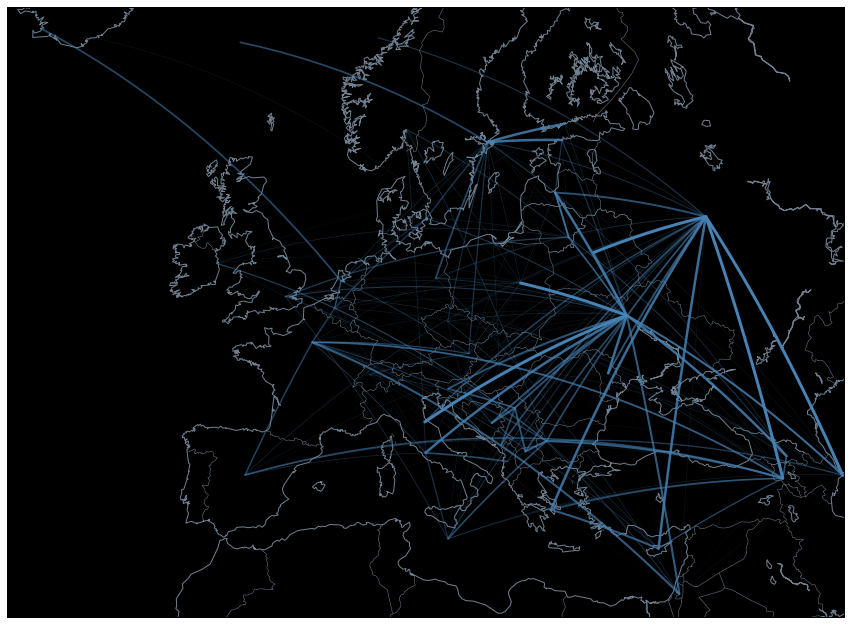

In [306]:
# create new figure, axes instances.
fig, ax = plt.subplots(figsize=[15,15])
# setup mercator map projection.
m = Basemap(llcrnrlon=-25.,llcrnrlat=30.,urcrnrlon=50.,urcrnrlat=65.,
            rsphere=(6378137.00,6356752.3142),
            resolution='l',projection='merc',
            lat_0=40.,lon_0=-20.,lat_ts=20.)

m.drawcoastlines(color='slategrey')
m.drawmapboundary(fill_color='black')
m.fillcontinents(color='black', lake_color='black');
m.drawcountries(color='slategrey');


for _, row in dff_tot.iterrows():
    from_c = row['From country']
    to_c = row['To country']
    w = row['tot_points_rel']**2
    if from_c != 'Australia' and to_c != 'Australia':
        draw_countries_line(from_c, to_c, 3*w, color='steelblue', alpha=w)

#### evolution map

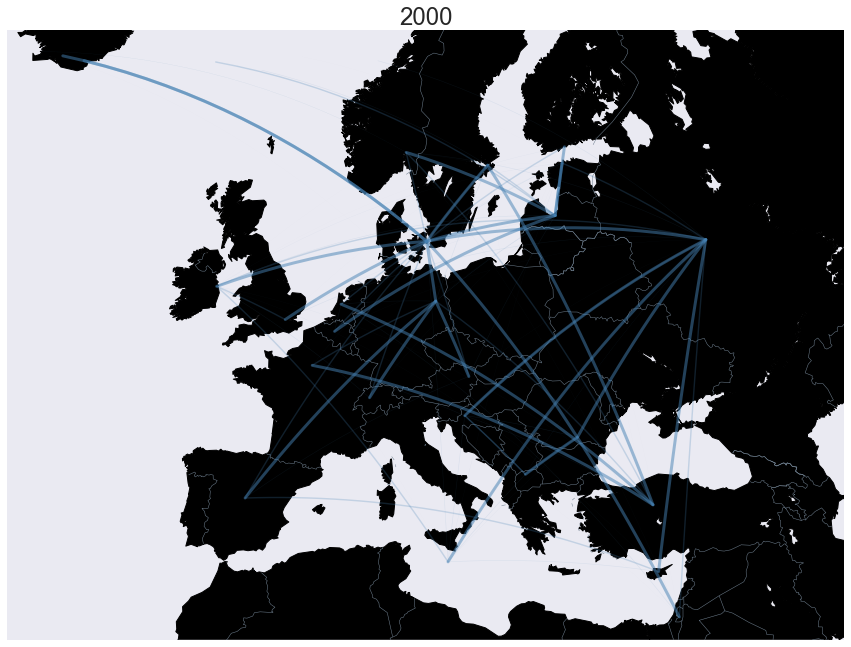

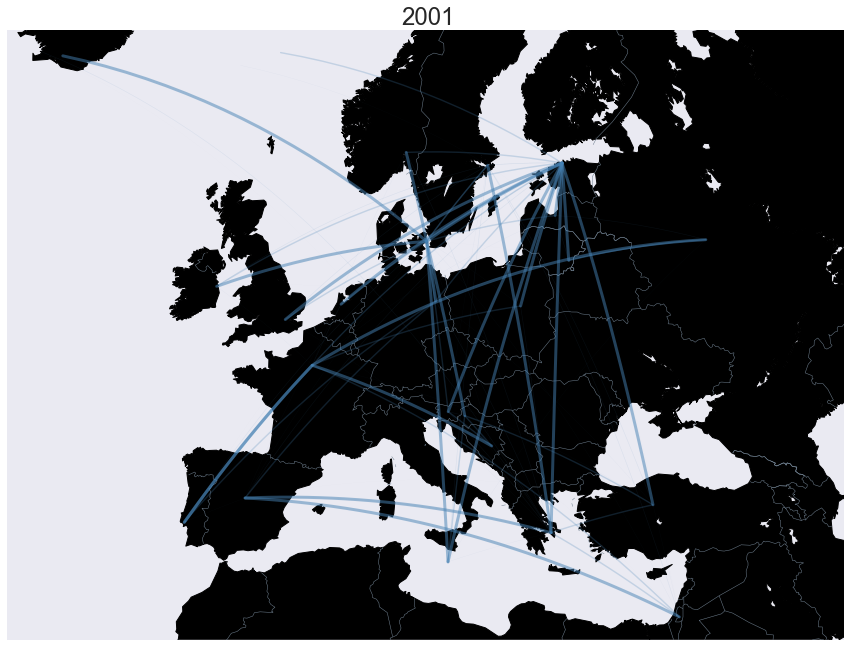

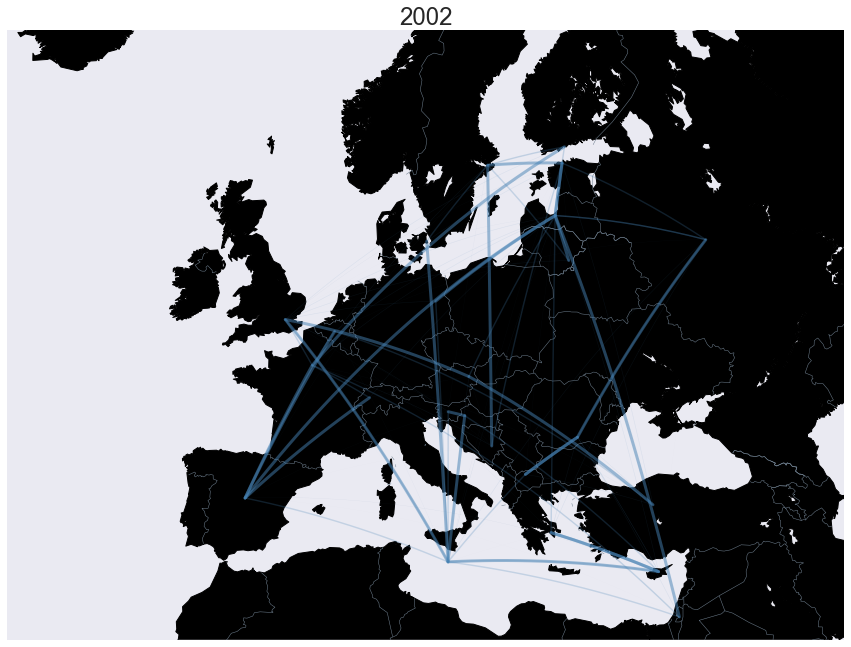

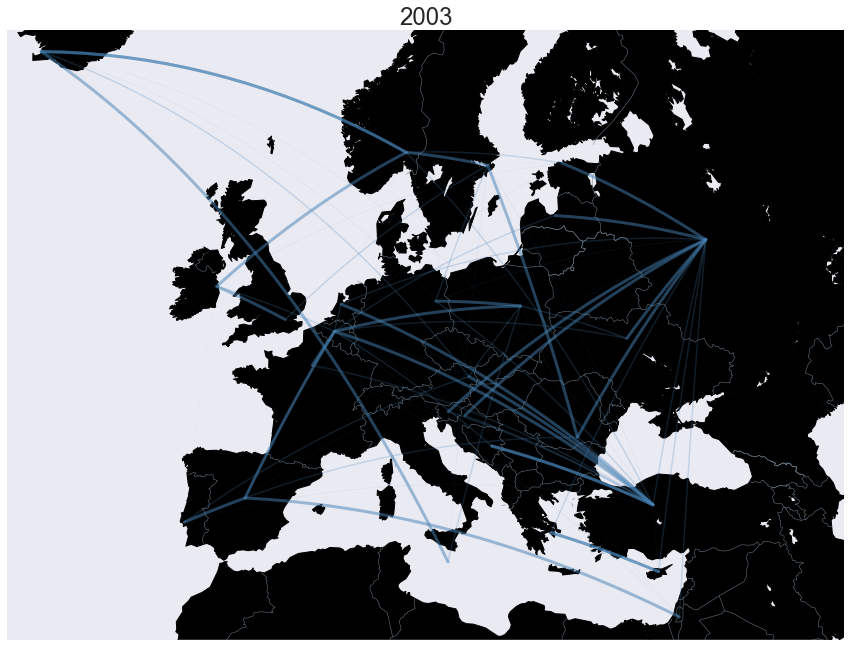

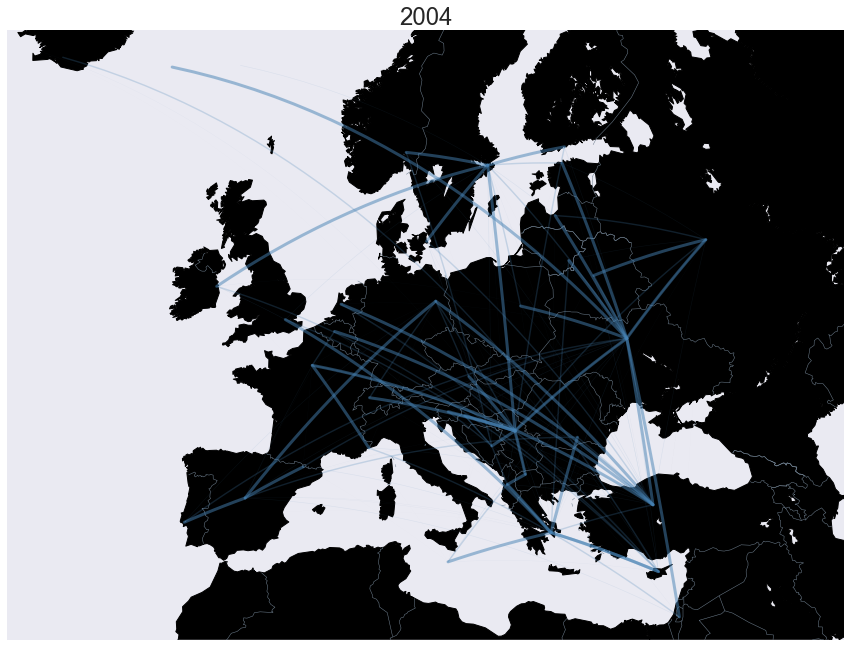

...

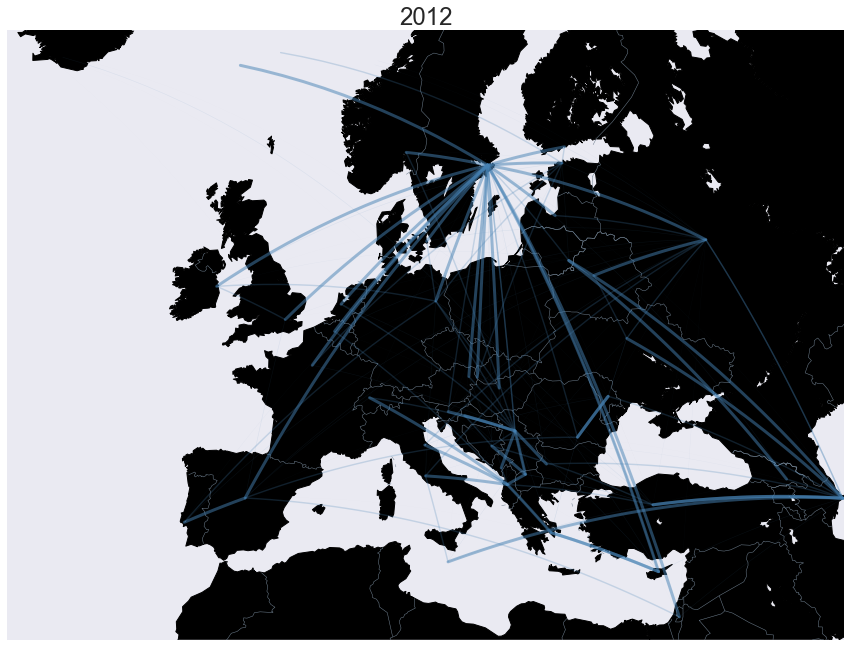

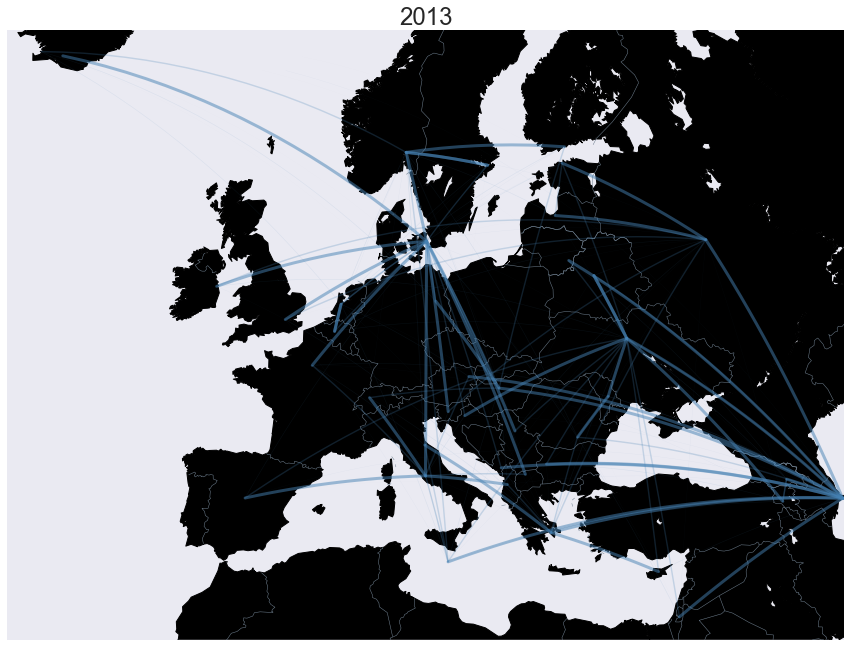

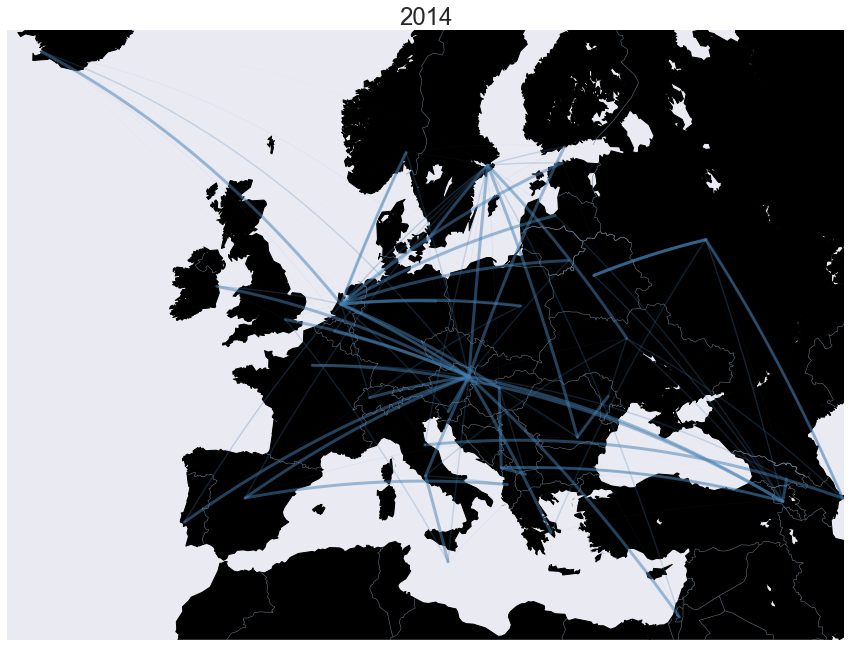

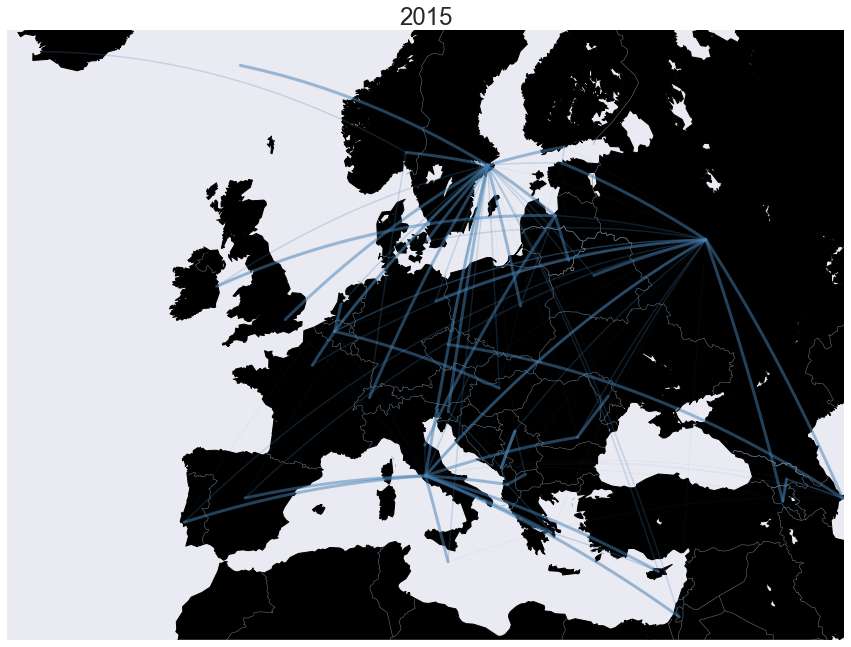

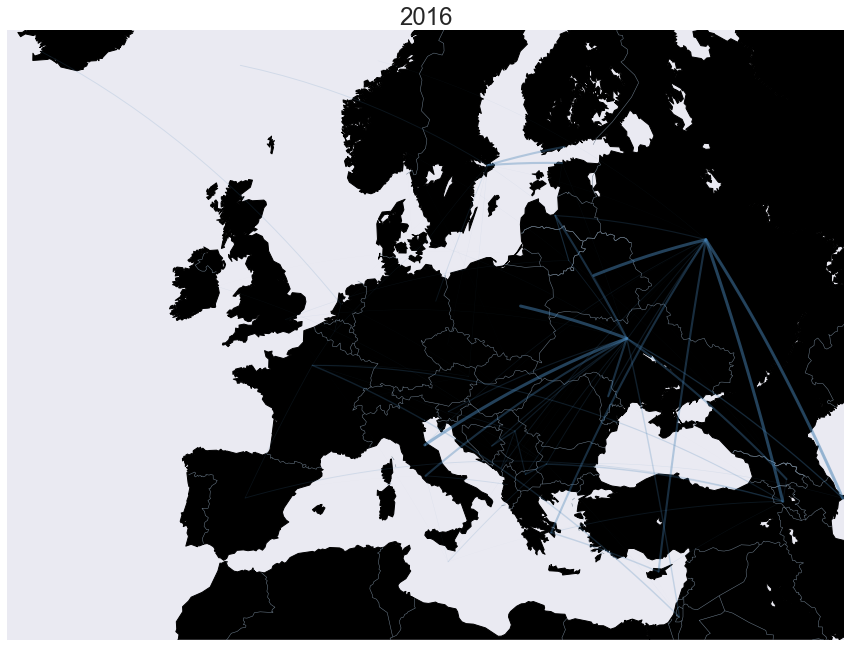

In [307]:
from_year = 2000
to_year = 2016

for year in range(from_year, to_year+1):
    
    # create new figure, axes instances.
    fig, ax = plt.subplots(figsize=[15,15])
    # setup mercator map projection.
    m = Basemap(llcrnrlon=-25.,llcrnrlat=30.,urcrnrlon=50.,urcrnrlat=65.,
                rsphere=(6378137.00,6356752.3142),
                resolution='l',projection='merc',
                lat_0=40.,lon_0=-20.,lat_ts=20.)

    m.drawcoastlines()
    m.fillcontinents(color='black');
    m.drawcountries(color='slategrey');
    
    dff_tot_y = dffp.loc[(year,),:].drop('tot_points', 1).groupby(level=0).mean().unstack().reset_index(name='tot_points')
    dff_tot_y['tot_points_rel'] = zero_one_ize(dff_tot_y['tot_points'])
    
    for _, row in dff_tot.iterrows():
        from_c = row['From country']
        to_c = row['To country']
        w = row['tot_points_rel']**4
        if from_c != 'Australia' and to_c != 'Australia':
            line = draw_countries_line(from_c, to_c, 3*w, color='steelblue', alpha=w*.5)
    
    ax.set_title('%d' %year, fontsize=24)
    fig.savefig('./graphs/map_001/%d.png' %year)

### mutual high vote networks

In [308]:
from itertools import combinations

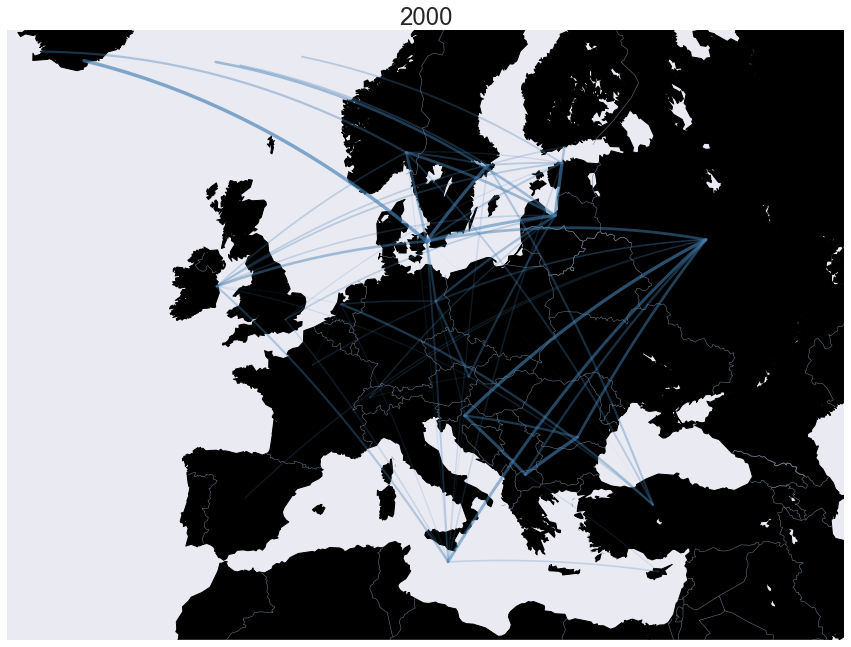

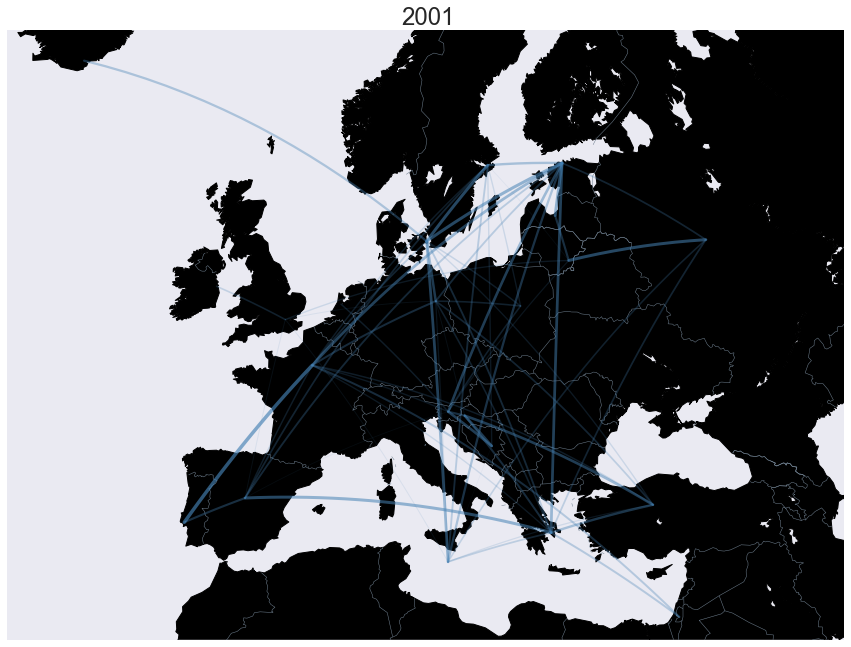

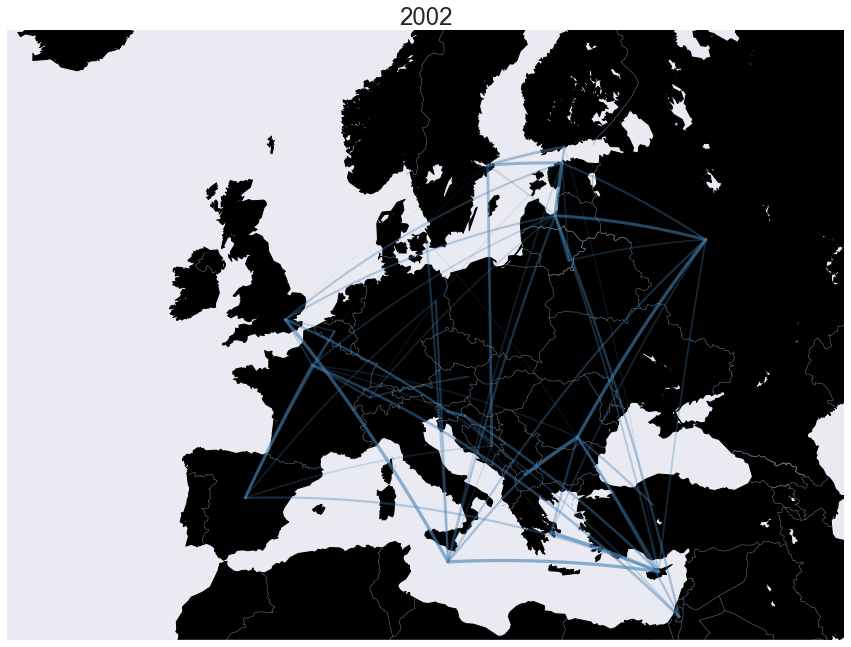

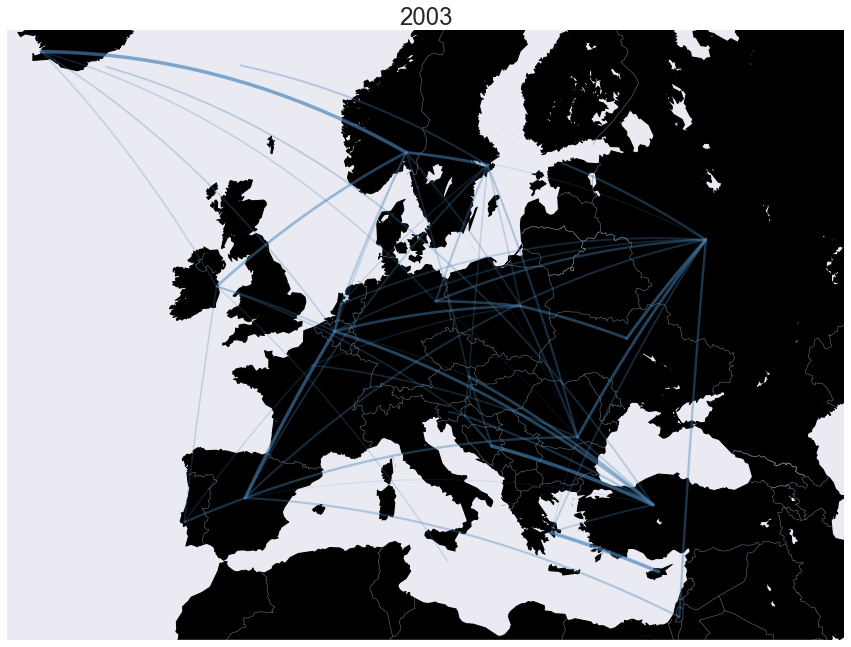

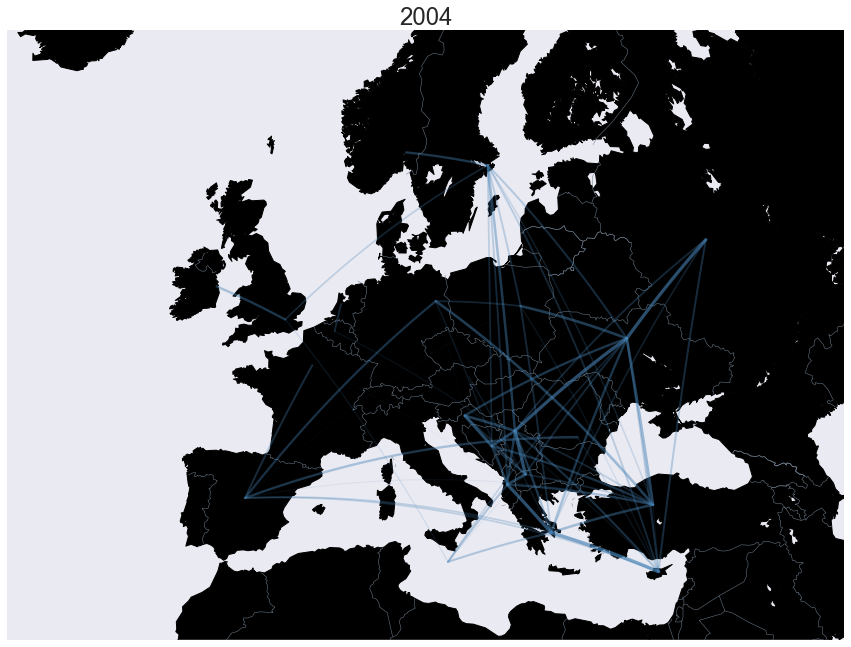

...

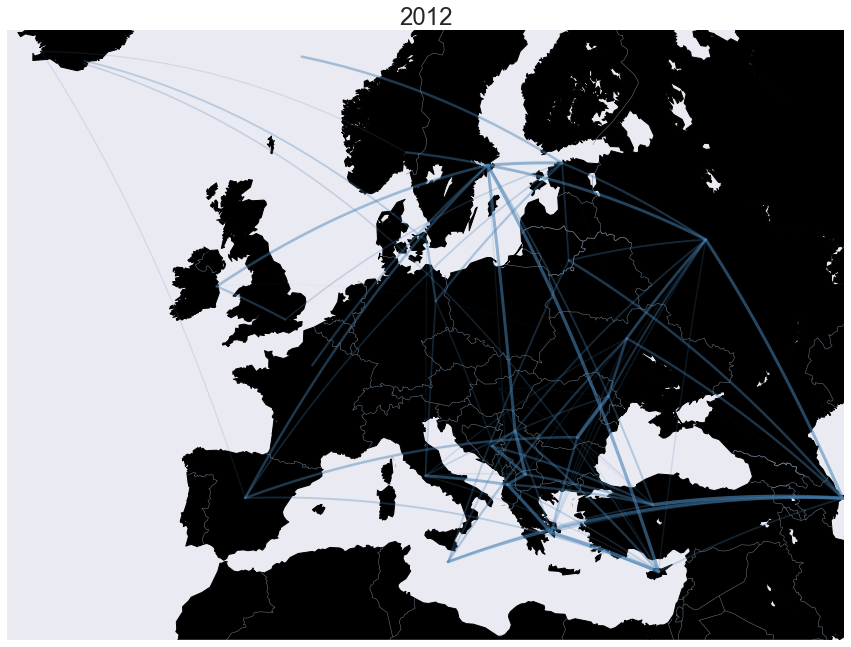

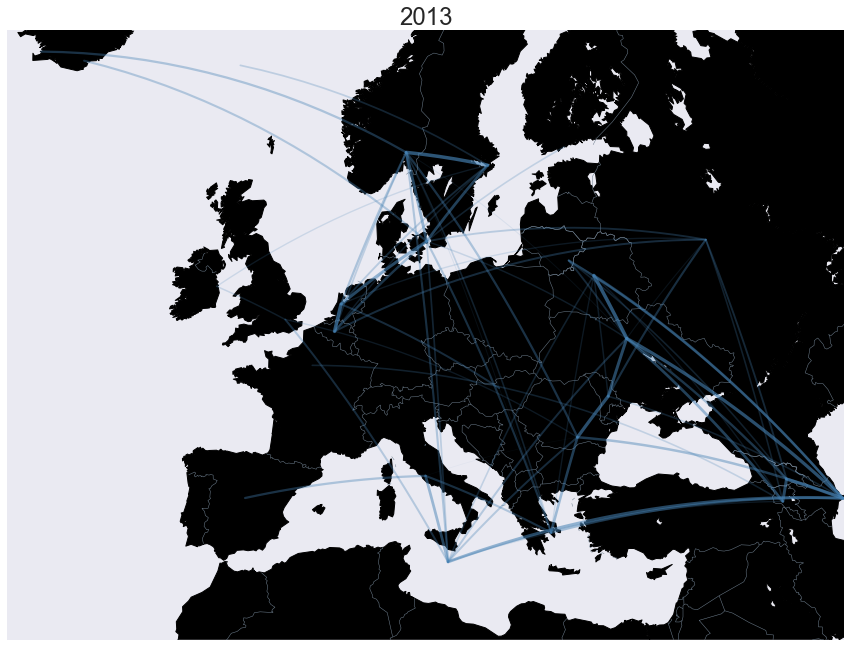

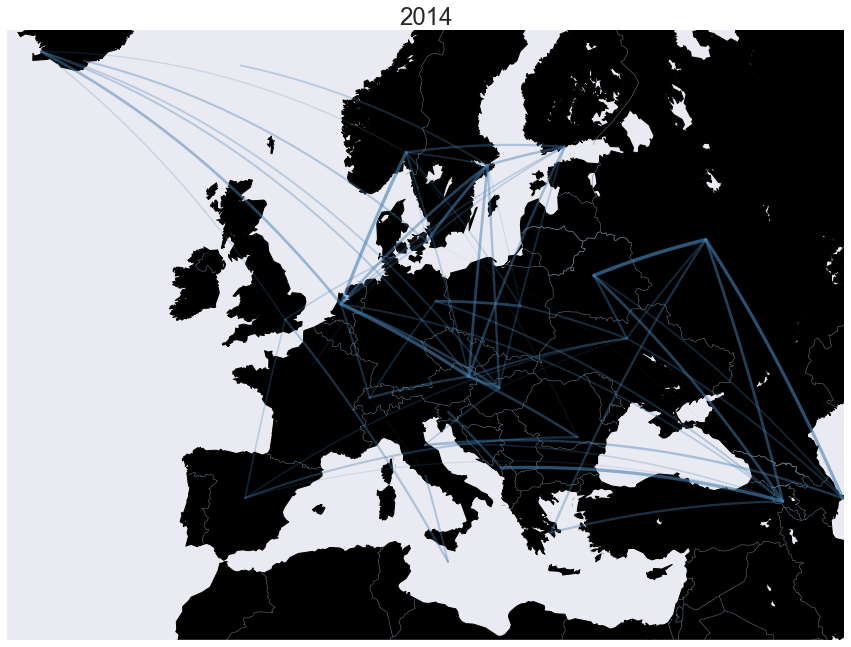

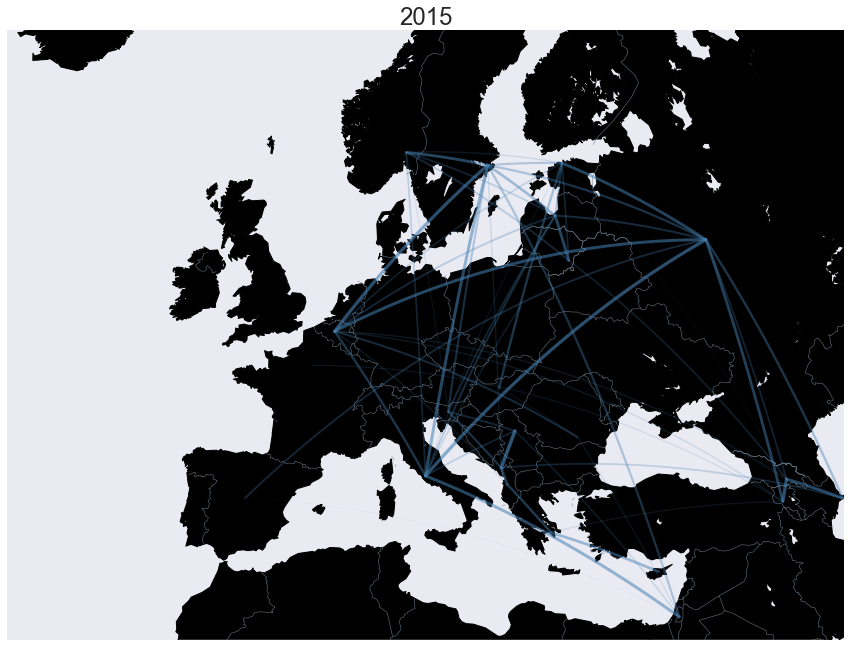

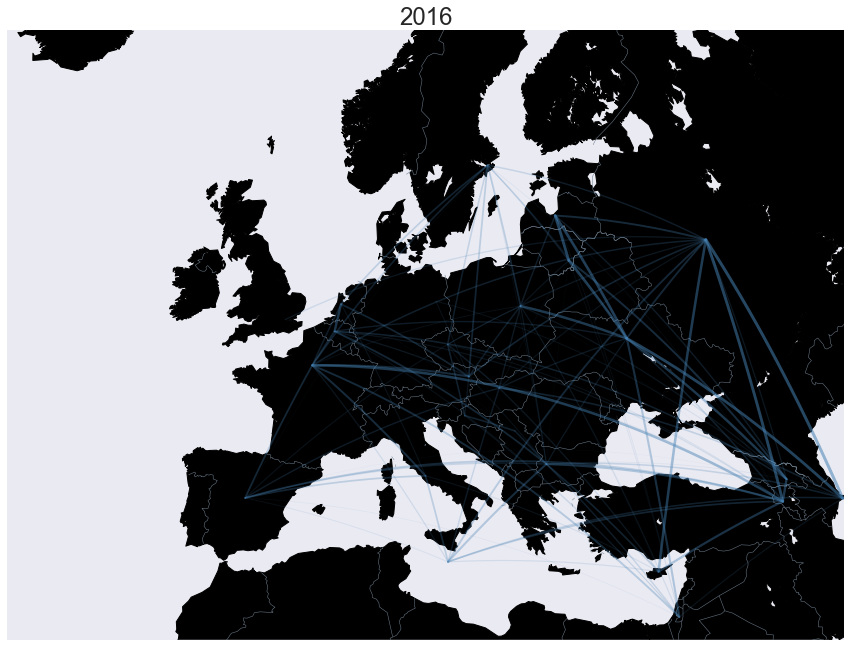

In [364]:
from_year = 2000
to_year = 2016

min_points = 0

for year in range(from_year, to_year+1):
    
    # create new figure, axes instances.
    fig, ax = plt.subplots(figsize=[15,15])
    # setup mercator map projection.
    m = Basemap(llcrnrlon=-25.,llcrnrlat=30.,urcrnrlon=50.,urcrnrlat=65.,
                rsphere=(6378137.00,6356752.3142),
                resolution='l',projection='merc',
                lat_0=40.,lon_0=-20.,lat_ts=20.)

    m.drawcoastlines()
    m.fillcontinents(color='black');
    m.drawcountries(color='slategrey');
    
    dff_tot_y = dffp.loc[(year,),:].drop('tot_points', 1).groupby(level=0).mean().unstack().reset_index(name='tot_points')
    country_pairs = combinations(dff_tot_y['From country'].unique(), 2)
    
    for ca, cb in country_pairs:
        ma = (dff_tot_y['From country'] == ca) & (dff_tot_y['To country'] == cb)
        wa = (dff_tot_y[ma]['tot_points'].values if ma.sum() > 0 else 0)
        mb = (dff_tot_y['From country'] == cb) & (dff_tot_y['To country'] == ca)
        wb = (dff_tot_y[mb]['tot_points'].values if mb.sum() > 0 else 0)
        w = (min(wa, wb) > min_points) * (np.mean([wa, wb]) - min_points) / (12 - min_points)
        if 'Australia' not in (ca, cb):
            line = draw_countries_line(ca, cb, .5*(w>0)+w*3, color='steelblue', alpha=.66*w)
    
    ax.set_title('%d' %year, fontsize=24)
    fig.savefig('./graphs/map_002/%d.png' %year)

In [360]:
coce[coce['CountryName'] == 'Iceland']

,CountryName,CapitalName,CapitalLatitude,CapitalLongitude,CountryCode,ContinentName
102,Iceland,Reykjavik,64.15,-21.95,IS,Europe


In [361]:
dff_tot_y[(dff_tot_y['From country'] == 'Estonia')]

,From country,To country,tot_points
360,Estonia,Austria,0
361,Estonia,Belgium,0
362,Estonia,Croatia,0
363,Estonia,Cyprus,0
364,Estonia,Denmark,8
365,Estonia,Estonia,0
366,Estonia,F.Y.R. Macedonia,0
367,Estonia,Finland,7
368,Estonia,France,0
369,Estonia,Germany,0


In [326]:
dff_tot_y[(dff_tot_y['From country'] == 'Albania') & (dff_tot_y['To country'] == 'Belgium')]['tot_points']

1    0
Name: tot_points, dtype: float64